# Analytics for Financial Services

**Kaggle Competition:** [Santander Customer Transaction Prediction](https://www.kaggle.com/c/santander-customer-transaction-prediction)


**Group Members:** Guillermo Chacon, Diego Cuartas, Esteban Delgado, Aayush Kejriwal, Denis Mochalov, Marang Mutloatse, Mariana Narvaez and Valentina Premoli

This notebook contains the sequential approach to solving the Santander Customer Transaction Prediction. You will see that by applying different methodologies we were able to achieve a **final position on the Public Leader Board of 59 with a score of 0.9224**

## Libraries

In [3]:
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold
from scipy.special import logit
warnings.filterwarnings('ignore')

In [4]:
train_df = pd.read_csv("./input/train.csv")
test_df = pd.read_csv("./input/test.csv")

In [5]:
train_df.shape, test_df.shape

((200000, 202), (200000, 201))

## Data Inspection

Let's get a glance of the train and test data

In [6]:
train_df.head(10)

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
5,train_5,0,11.4763,-2.3182,12.6080,8.6264,10.9621,3.5609,4.5322,15.2255,...,-6.3068,6.6025,5.2912,0.4403,14.9452,1.0314,-3.6241,9.7670,12.5809,-4.7602
6,train_6,0,11.8091,-0.0832,9.3494,4.2916,11.1355,-8.0198,6.1961,12.0771,...,8.7830,6.4521,3.5325,0.1777,18.3314,0.5845,9.1104,9.1143,10.8869,-3.2097
7,train_7,0,13.5580,-7.9881,13.8776,7.5985,8.6543,0.8310,5.6890,22.3262,...,13.1700,6.5491,3.9906,5.8061,23.1407,-0.3776,4.2178,9.4237,8.6624,3.4806
8,train_8,0,16.1071,2.4426,13.9307,5.6327,8.8014,6.1630,4.4514,10.1854,...,1.4298,14.7510,1.6395,1.4181,14.8370,-1.9940,-1.0733,8.1975,19.5114,4.8453
9,train_9,0,12.5088,1.9743,8.8960,5.4508,13.6043,-16.2859,6.0637,16.8410,...,0.5543,6.3160,1.0371,3.6885,14.8344,0.4467,14.1287,7.9133,16.2375,14.2514


In [7]:
test_df.head()

,ID_code,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,test_0,11.0656,7.7798,12.9536,9.4292,11.4327,-2.3805,5.8493,18.2675,2.1337,...,-2.1556,11.8495,-1.4300,2.4508,13.7112,2.4669,4.3654,10.7200,15.4722,-8.7197
1,test_1,8.5304,1.2543,11.3047,5.1858,9.1974,-4.0117,6.0196,18.6316,-4.4131,...,10.6165,8.8349,0.9403,10.1282,15.5765,0.4773,-1.4852,9.8714,19.1293,-20.9760
2,test_2,5.4827,-10.3581,10.1407,7.0479,10.2628,9.8052,4.8950,20.2537,1.5233,...,-0.7484,10.9935,1.9803,2.1800,12.9813,2.1281,-7.1086,7.0618,19.8956,-23.1794
3,test_3,8.5374,-1.3222,12.0220,6.5749,8.8458,3.1744,4.9397,20.5660,3.3755,...,9.5702,9.0766,1.6580,3.5813,15.1874,3.1656,3.9567,9.2295,13.0168,-4.2108
4,test_4,11.7058,-0.1327,14.1295,7.7506,9.1035,-8.5848,6.8595,10.6048,2.9890,...,4.2259,9.1723,1.2835,3.3778,19.5542,-0.2860,-5.1612,7.2882,13.9260,-9.1846


In [8]:
train_df.shape, test_df.shape

((200000, 202), (200000, 201))

Let's check for the **data types** of the entries.

In [9]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 202 entries, ID_code to var_199
dtypes: float64(200), int64(1), object(1)
memory usage: 308.2+ MB


In [10]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 201 entries, ID_code to var_199
dtypes: float64(200), object(1)
memory usage: 306.7+ MB


Let's check for **missing** values in the train and test sets.

In [11]:
train_df.isnull().sum().any(),test_df.isnull().sum().any()

(False, False)

In [12]:
train_df.describe()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,...,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,0.100490,10.679914,-1.627622,10.715192,6.796529,11.078333,-5.065317,5.408949,16.545850,0.284162,...,3.234440,7.438408,1.927839,3.331774,17.993784,-0.142088,2.303335,8.908158,15.870720,-3.326537
std,0.300653,3.040051,4.050044,2.640894,2.043319,1.623150,7.863267,0.866607,3.418076,3.332634,...,4.559922,3.023272,1.478423,3.992030,3.135162,1.429372,5.454369,0.921625,3.010945,10.438015
min,0.000000,0.408400,-15.043400,2.117100,-0.040200,5.074800,-32.562600,2.347300,5.349700,-10.505500,...,-14.093300,-2.691700,-3.814500,-11.783400,8.694400,-5.261000,-14.209600,5.960600,6.299300,-38.852800
25%,0.000000,8.453850,-4.740025,8.722475,5.254075,9.883175,-11.200350,4.767700,13.943800,-2.317800,...,-0.058825,5.157400,0.889775,0.584600,15.629800,-1.170700,-1.946925,8.252800,13.829700,-11.208475
50%,0.000000,10.524750,-1.608050,10.580000,6.825000,11.108250,-4.833150,5.385100,16.456800,0.393700,...,3.203600,7.347750,1.901300,3.396350,17.957950,-0.172700,2.408900,8.888200,15.934050,-2.819550
75%,0.000000,12.758200,1.358625,12.516700,8.324100,12.261125,0.924800,6.003000,19.102900,2.937900,...,6.406200,9.512525,2.949500,6.205800,20.396525,0.829600,6.556725,9.593300,18.064725,4.836800
max,1.000000,20.315000,10.376800,19.353000,13.188300,16.671400,17.251600,8.447700,27.691800,10.151300,...,18.440900,16.716500,8.402400,18.281800,27.928800,4.272900,18.321500,12.000400,26.079100,28.500700


In [13]:
test_df.describe()

,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,...,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,10.658737,-1.624244,10.707452,6.788214,11.076399,-5.050558,5.415164,16.529143,0.277135,7.569407,...,3.189766,7.458269,1.925944,3.322016,17.996967,-0.133657,2.290899,8.912428,15.869184,-3.246342
std,3.036716,4.040509,2.633888,2.052724,1.616456,7.869293,0.864686,3.424482,3.333375,1.231865,...,4.551239,3.025189,1.479966,3.995599,3.140652,1.429678,5.446346,0.920904,3.008717,10.398589
min,0.188700,-15.043400,2.355200,-0.022400,5.484400,-27.767000,2.216400,5.713700,-9.956000,4.243300,...,-14.093300,-2.407000,-3.340900,-11.413100,9.382800,-4.911900,-13.944200,6.169600,6.584000,-39.457800
25%,8.442975,-4.700125,8.735600,5.230500,9.891075,-11.201400,4.772600,13.933900,-2.303900,6.623800,...,-0.095000,5.166500,0.882975,0.587600,15.634775,-1.160700,-1.948600,8.260075,13.847275,-11.124000
50%,10.513800,-1.590500,10.560700,6.822350,11.099750,-4.834100,5.391600,16.422700,0.372000,7.632000,...,3.162400,7.379000,1.892600,3.428500,17.977600,-0.162000,2.403600,8.892800,15.943400,-2.725950
75%,12.739600,1.343400,12.495025,8.327600,12.253400,0.942575,6.005800,19.094550,2.930025,8.584825,...,6.336475,9.531100,2.956000,6.174200,20.391725,0.837900,6.519800,9.595900,18.045200,4.935400
max,22.323400,9.385100,18.714100,13.142000,16.037100,17.253700,8.302500,28.292800,9.665500,11.003600,...,20.359000,16.716500,8.005000,17.632600,27.947800,4.545400,15.920700,12.275800,26.538400,27.907400


## Exploratory Data Analysis:

Let's check the distribution of **target** value in train dataset.

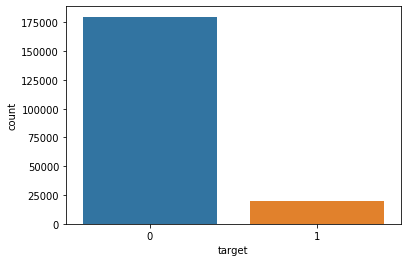

In [14]:
sns.countplot(train_df['target'])

In [15]:
print("There are {}% target values with 1".format(100 * train_df["target"].value_counts()[1]/train_df.shape[0]))

There are 10.049% target values with 1


Let's check the **distributions** of some of the features with the target variables

In [16]:
def plot_feature_distribution(df1, df2, label1, label2, features):
    i = 0
    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(5,10,figsize=(18,22))

    for feature in features:
        i += 1
        plt.subplot(5,10,i)
        sns.kdeplot(df1[feature], bw=0.5,label=label1)
        sns.kdeplot(df2[feature], bw=0.5,label=label2)
        plt.xlabel(feature, fontsize=9)
        locs, labels = plt.xticks()
        plt.tick_params(axis='x', which='major', labelsize=6, pad=-6)
        plt.tick_params(axis='y', which='major', labelsize=6)
    plt.show();

<Figure size 432x288 with 0 Axes>

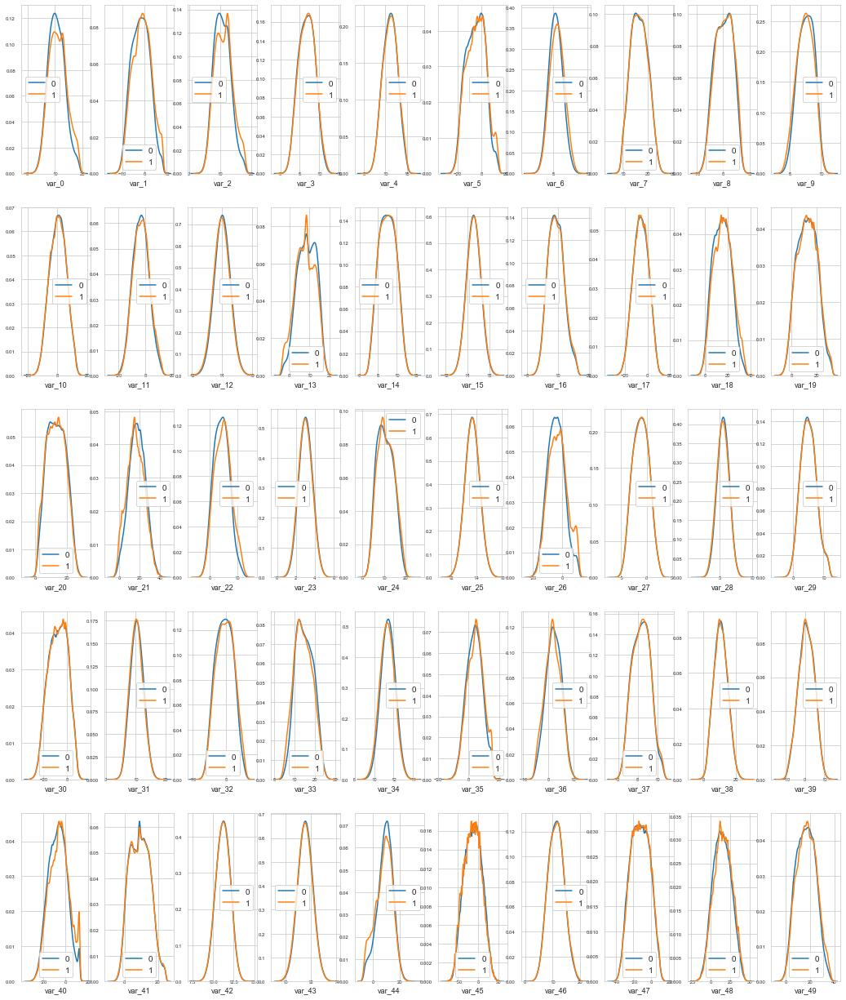

In [17]:
t0 = train_df.loc[train_df['target'] == 0]
t1 = train_df.loc[train_df['target'] == 1]
features = train_df.columns.values[2:52]
plot_feature_distribution(t0, t1, '0', '1', features)

It is observed that there is not always **normal distribution**, in some cases and classes we can observe almost bimodal distribution and noise. 

Now we check that test and train sets are the same, i.e. they come from the same sample and they represent the whole population. Lets plot it for first 50 variables.


<Figure size 432x288 with 0 Axes>

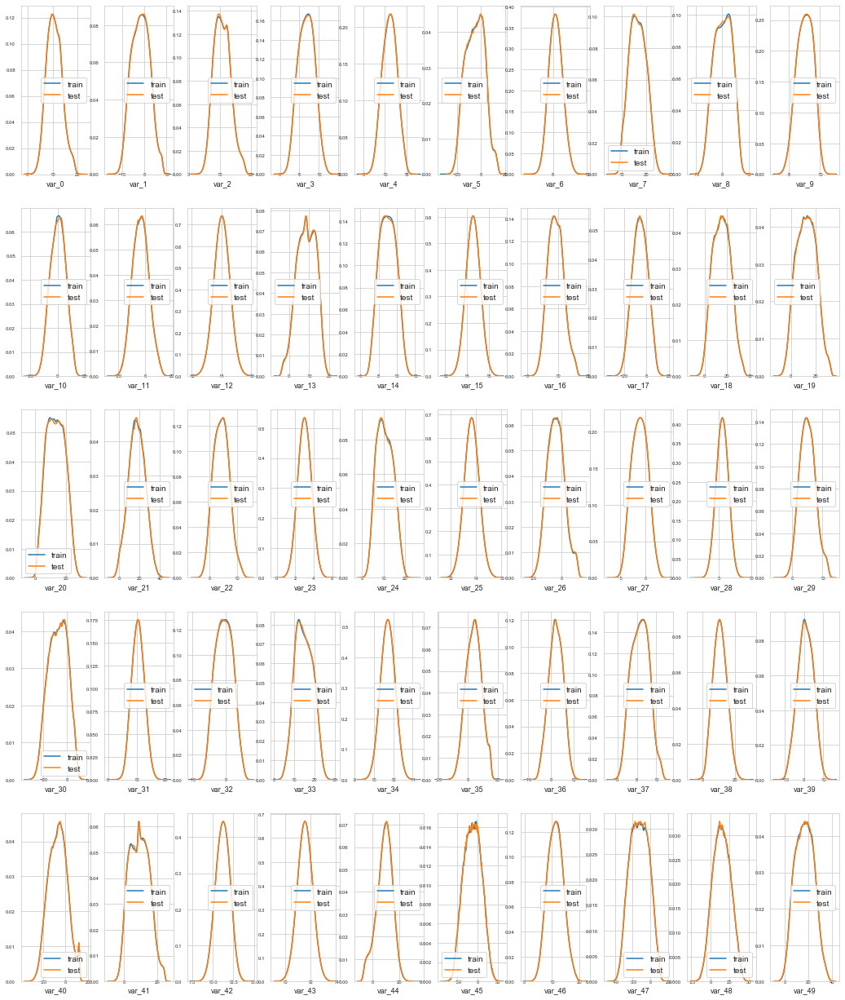

In [18]:
features1 = train_df.columns.values[2:52]
plot_feature_distribution(train_df, test_df, 'train', 'test', features1)

Let's check if there is **correlation** between features.

In [19]:
corr = train_df.corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(4)

In [20]:
corr1 = test_df.corr()
corr1.style.background_gradient(cmap='coolwarm').set_precision(4)

## Baseline Model


In [21]:
features = [c for c in train_df.columns if c not in ['ID_code', 'target']]
target = train_df['target']

### LightGBM Parameters


In [22]:
param = {
    'bagging_freq': 5,
    'bagging_fraction': 0.4,
    'boost_from_average':'false',
    'boost': 'gbdt',
    'feature_fraction': 0.05,
    'learning_rate': 0.01,
    'max_depth': -1,  
    'metric':'auc',
    'min_data_in_leaf': 80,
    'min_sum_hessian_in_leaf': 10.0,
    'num_leaves': 13,
    'num_threads': 8,
    'tree_learner': 'serial',
    'objective': 'binary', 
    'verbosity': 1
} 


### Stratified K_Folds:

The model that we chose for the competition is a Stratified OOF model with a LightGB model, the reason for this choice is mainly because stratifiying the data and making K= 10 fold predictions to average them, helps you avoid overfitting on your data set, since the data set is not enormous and lets us predict using fold distribution it helps increase the prediction power of the model.

So for this model we will an 10 Folds of Train/validation (Train 91% of the data, Val 9%) to optimize the number of iterators and then with that optimal train we will predict the test set, once we have the 10 fold predictions we will avreage them to get a final prediction for the test set.

More over LGBM is a new model similar to XGboost that has been consistently showing good results in kaggle competitions, some of their advantages are:

    1. Faster training speed and higher efficiency: Light GBM use histogram based algorithm i.e it buckets continuous feature values into discrete bins which fasten the training procedure.
    2. Lower memory usage: Replaces continuous values to discrete bins which result in lower memory usage.
    3. Better accuracy than any other boosting algorithm: It produces much more complex trees by following leaf wise split approach rather than a level-wise approach which is the main factor in achieving higher accuracy. However, it can sometimes lead to overfitting which can be avoided by setting the max_depth parameter.
    4. Compatibility with Large Datasets: It is capable of performing equally good with large datasets with a significant reduction in training time as compared to XGBOOST.
    5. Parallel learning supported.

More information about this Model on:

https://www.analyticsvidhya.com/blog/2017/06/which-algorithm-takes-the-crown-light-gbm-vs-xgboost/
https://papers.nips.cc/paper/6907-lightgbm-a-highly-efficient-gradient-boosting-decision-tree.pdf

In [23]:
folds = StratifiedKFold(n_splits=5, shuffle=False, random_state=15)
oof = np.zeros(len(train_df))
predictions = np.zeros(len(test_df))
feature_importance_df = pd.DataFrame()

for fold_, (trn_idx, val_idx) in enumerate(folds.split(train_df.values, target.values)):
    print("Fold {}".format(fold_))
    trn_data = lgb.Dataset(train_df.iloc[trn_idx][features], label=target.iloc[trn_idx])
    val_data = lgb.Dataset(train_df.iloc[val_idx][features], label=target.iloc[val_idx])

    clf = lgb.train(param, trn_data, 1000000, valid_sets = [trn_data, val_data], verbose_eval=1000, early_stopping_rounds = 3000)
    oof[val_idx] = clf.predict(train_df.iloc[val_idx][features], num_iteration=clf.best_iteration)
    
    fold_importance_df = pd.DataFrame()
    fold_importance_df["Feature"] = features
    fold_importance_df["importance"] = clf.feature_importance()
    fold_importance_df["fold"] = fold_ + 1
    feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
    
    predictions += clf.predict(test_df[features], num_iteration=clf.best_iteration) / folds.n_splits

print("CV score: {:<8.5f}".format(roc_auc_score(target, oof)))

Fold 0
Training until validation scores don't improve for 3000 rounds
[1000]	training's auc: 0.901282	valid_1's auc: 0.880778
[2000]	training's auc: 0.913504	valid_1's auc: 0.889063
[3000]	training's auc: 0.921622	valid_1's auc: 0.893543
[4000]	training's auc: 0.927569	valid_1's auc: 0.895938
[5000]	training's auc: 0.932691	valid_1's auc: 0.897345
[6000]	training's auc: 0.93727	valid_1's auc: 0.897951
[7000]	training's auc: 0.941462	valid_1's auc: 0.898465
[8000]	training's auc: 0.945381	valid_1's auc: 0.898999
[9000]	training's auc: 0.949131	valid_1's auc: 0.899072
[10000]	training's auc: 0.952614	valid_1's auc: 0.89908
[11000]	training's auc: 0.956011	valid_1's auc: 0.899024
[12000]	training's auc: 0.959244	valid_1's auc: 0.899003
[13000]	training's auc: 0.962322	valid_1's auc: 0.898864
Early stopping, best iteration is:
[10168]	training's auc: 0.953171	valid_1's auc: 0.899138
Fold 1
Training until validation scores don't improve for 3000 rounds
[1000]	training's auc: 0.901823	valid_

### Submission 1

In [24]:
sub_df = pd.DataFrame({"ID_code":test_df["ID_code"].values})
sub_df["target"] = predictions
sub_df.to_csv("submission1.csv", index=False)

### Baseline Score:
**- Public Leaderboard:** 0.90013
**- Position:** 3.465

## Data Augmentation:
this technique is similar to Oversampling , but , here we oversample both classses , rather than just one. 

In [25]:
train_df = pd.read_csv("./input/train.csv").drop("ID_code",axis=1)
test_df = pd.read_csv("./input/test.csv").drop("ID_code",axis=1)

In [26]:
def augment(train,num_n=1,num_p=2):
    newtrain=[train]
    
    n=train[train.target==0]
    for i in range(num_n):
        newtrain.append(n.apply(lambda x:x.values.take(np.random.permutation(len(n)))))
    
    for i in range(num_p):
        p=train[train.target>0]
        newtrain.append(p.apply(lambda x:x.values.take(np.random.permutation(len(p)))))
        
    return pd.concat(newtrain)

In [27]:
param = {
    "objective" : "binary",
    "metric" : "auc",
    "boosting": 'gbdt',
    "max_depth" : -1,
    "num_leaves" : 13,
    "learning_rate" : 0.01,
    "bagging_freq": 5,
    "bagging_fraction" : 0.4,
    "feature_fraction" : 0.05,
    "min_data_in_leaf": 80,
    "min_sum_heassian_in_leaf": 10,
    "tree_learner": "serial",
    "boost_from_average": "false",
    "bagging_seed" : 10,
    "verbosity" : 1,
}

In [28]:
predictions = np.zeros(test_df.shape[0])

folds = StratifiedKFold(n_splits=5,random_state=15)
for fold_,(train_index, valid_index) in enumerate(folds.split(train_df, train_df.target),1):
    print("Fold {}".format(fold_))
    t=train_df.iloc[train_index]
    t=augment(t)
    trn_data = lgb.Dataset(t.drop("target",axis=1), label=t.target)
    
    v=train_df.iloc[valid_index]
    val_data = lgb.Dataset(v.drop("target",axis=1), label=v.target)
    
    model = lgb.train(param, trn_data, 1000000, valid_sets = [val_data], verbose_eval=1000, early_stopping_rounds = 3000)
    predictions +=model.predict(test_df)

Fold 1
Training until validation scores don't improve for 3000 rounds
[1000]	valid_0's auc: 0.879352
[2000]	valid_0's auc: 0.886867
[3000]	valid_0's auc: 0.891362
[4000]	valid_0's auc: 0.89454
[5000]	valid_0's auc: 0.89661
[6000]	valid_0's auc: 0.89803
[7000]	valid_0's auc: 0.89892
[8000]	valid_0's auc: 0.899496
[9000]	valid_0's auc: 0.89975
[10000]	valid_0's auc: 0.900009
[11000]	valid_0's auc: 0.900092
[12000]	valid_0's auc: 0.90001
[13000]	valid_0's auc: 0.899908
[14000]	valid_0's auc: 0.899874
Early stopping, best iteration is:
[11152]	valid_0's auc: 0.900114
Fold 2
Training until validation scores don't improve for 3000 rounds
[1000]	valid_0's auc: 0.875618
[2000]	valid_0's auc: 0.885025
[3000]	valid_0's auc: 0.889933
[4000]	valid_0's auc: 0.893041
[5000]	valid_0's auc: 0.894824
[6000]	valid_0's auc: 0.896113
[7000]	valid_0's auc: 0.896851
[8000]	valid_0's auc: 0.897201
[9000]	valid_0's auc: 0.897439
[10000]	valid_0's auc: 0.897502
[11000]	valid_0's auc: 0.897598
[12000]	valid_0's

### Submission 2


In [29]:
sub_df = pd.read_csv('./input/sample_submission.csv')
sub_df = pd.DataFrame({"ID_code":sub_df["ID_code"], "target":predictions/fold_})
sub_df.to_csv("submission2.csv", index=False)

### Second Submission Score:
**- Public Leaderboard:** 0.90103 
**- Position:** 2553



## Frequency Count + LGBM per Column + Logit
In addition to the original 200 variables, we found that the frequency in which each value within the features occur help increase the discriminative power of our ensemble. To do this, for each feature, we use value_counts() to get the number of times each unique value occurs, and use it along with the original variable in the lgbm model. Therefore, we have 200 columns for frequency counts along with the 200 original variables. We found that there is not a strong correlation between any pair of original variables, and therefore interactions between them are not important. On the other hand, interactions between the variable and the feature counts of that variable are important. So we build 200 lgbm models, each using an original variable and its corresponding feature count, to predict the target. And at the end combine the 200 predictions using the logit.

In [30]:
train_df = pd.read_csv("./input/train.csv")
test_df = pd.read_csv("./input/test.csv")

features = [c for c in train_df.columns if c not in ['ID_code', 'target']]

# Detecting Synthetic Samples
Freq_df = pd.DataFrame()
for var in features:
    var_stats = train_df[var].append(test_df[var]).value_counts()
    Freq_df[var] = pd.Series(test_df[var]).map(var_stats) 
    Freq_df[var] = Freq_df[var] > 1

# Frequency Distribution Encoding Train & Test
ind = Freq_df.sum(axis=1) != 200
var_stats = {var:train_df[var].append(test_df[ind][var]).value_counts() for var in features}

In [31]:
param = {
    'learning_rate':0.05, 
    'max_bin': 165, 
    'max_depth': 5, 
    'min_child_samples': 150,
    'min_child_weight': 0.1, 
    'min_split_gain': 0.0018, 
    'n_estimators': 41,
    'num_leaves': 6, 
    'reg_alpha': 2.0, 
    'reg_lambda': 2.54, 
    'objective': 'binary', 
    'n_jobs': -1
}

In [32]:
predictions = 0
for var in features:
    X_train = np.hstack([train_df[var].values.reshape(-1,1),train_df[var].map(var_stats[var]).values.reshape(-1,1)])
    Y_train = train_df["target"].values
    X_test = np.hstack([test_df[var].values.reshape(-1,1),test_df[var].map(var_stats[var]).values.reshape(-1,1)])
    
    model = lgb.LGBMClassifier(**param)
    model = model.fit(X_train,Y_train)
    predictions += logit(model.predict_proba(X_test)[:,1])


### Submission 3

In [33]:
sub_df = pd.DataFrame({"ID_code":test_df["ID_code"], "target":predictions})
sub_df.to_csv("submission3.csv", index=False)

## Best Submission Score:
### - Position: 59
### - Public Leaderboard: 0.92244 



### Acknowledgments:
We combined our machine learning knowledge with many ideas from different authors from the leaderboard.

- Using Light GBM and Hyper Parameter Fine Tunning.
- Using the Frequency Distribution for each Column as Feature / Data Augmentation.
- Creating a separate model per Variable and then finding coefficients with Logit to ensemble the predictions.

We also tried different classifiers and feature engineering pipelines(Those were not applied to our best model). 

Our final position in the Public Leader Board would be: **59** with a score: **0.92244**

- https://medium.com/@pushkarmandot/https-medium-com-pushkarmandot-what-is-lightgbm-how-to-implement-it-how-to-fine-tune-the-parameters-60347819b7fc
- https://www.kaggle.com/jiweiliu/lgb-2-leaves-augment
- https://www.kaggle.com/cdeotte/200-magical-models-santander-0-920/output#The-%22Magic%22-of-Santander
- https://www.kaggle.com/yag320/list-of-fake-samples-and-public-private-lb-split
- https://www.kaggle.com/cdeotte/modified-naive-bayes-santander-0-899